In [1]:
from mpl_toolkits.mplot3d import axes3d
import matplotlib.pyplot as plt
from matplotlib import cm
import numpy as np
from matplotlib import animation
import cv2
from scipy.interpolate import LinearNDInterpolator
import h5py
from scipy.interpolate import CloughTocher2DInterpolator
from wave_prop_module import Wave2d

In [2]:
6.45*1e-3 * 1040/2, 2*np.pi/0.5328, 650*1e-6/(2*np.sin(np.arctan(4.3/210))), 1392*0.00645*0.5

(3.354, 11.792765216177902, 0.0158754200555099, 4.4892)

## Sample Visualization in Space and Frequency Domain

In [3]:
sample = '05_02'
sample_name = f'samples/2024_01_30_Wolfgangs_Wavefront_Sensor_First_Test/Reconstruction/{sample}.mat'
 
A = np.array(h5py.File(sample_name, 'r').get('A'))
P = np.array(h5py.File(sample_name, 'r').get('phi'))*1e-6

wave_0= A*np.exp(1j*P)
wave_0 = wave_0.T

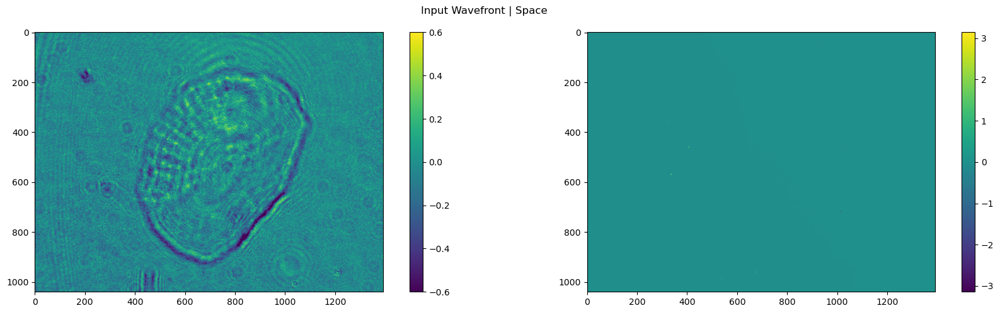

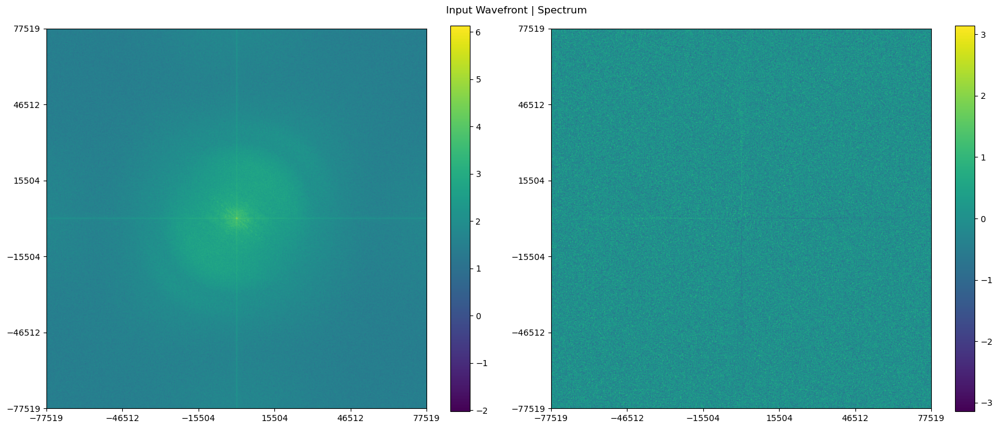

In [4]:
wave_obj = Wave2d(
    numPx = [1392, 1040], 
    sizePx = [0.00645, 0.00645], 
    wl = 650*1e-6
    # wl = 532.8*1e-6
    )

wave_obj.wavefield(wave_0)

# plot the wave in space
fig, axs = plt.subplots(1, 2, figsize=(18, 5), tight_layout=True)
cp_amp = axs[0].imshow(np.log10(np.abs(wave_obj.wavefield_z0)), vmax=0.6, vmin=-0.6)
cp_ang = axs[1].imshow((np.angle(wave_obj.wavefield_z0)))

fig.colorbar(cp_amp, ax=axs[0])
fig.colorbar(cp_ang, ax=axs[1])
fig.suptitle('Input Wavefront | Space')
plt.show()

# plot the spectrum
minFreqX, maxFreqX = -1/(2*wave_obj.sizePx[0]), 1/(2*wave_obj.sizePx[0])
minFreqY, maxFreqY = -1/(2*wave_obj.sizePx[1]), 1/(2*wave_obj.sizePx[1])

fig, axs = plt.subplots(1, 2, figsize=(17, 7), tight_layout=True)
# cp_amp = axs[0].imshow(np.log10(np.abs(wave_obj.fft_wave_z0)))
# cp_ang = axs[1].imshow((np.angle(wave_obj.fft_wave_z0)))

cp_amp = axs[0].imshow(np.log10(np.abs(wave_obj.fft_wave_z0)), 
                       extent=[minFreqX, maxFreqX, minFreqY, maxFreqY])

cp_ang = axs[1].imshow(np.angle(wave_obj.fft_wave_z0), 
                    #    cmap='twilight', 
                       extent=[minFreqX, maxFreqX, minFreqY, maxFreqY])

axs[0].set_xticks(np.linspace(minFreqX, maxFreqX, 6))
axs[0].set_yticks(np.linspace(minFreqY, maxFreqY, 6))

axs[1].set_xticks(np.linspace(minFreqX, maxFreqX, 6))
axs[1].set_yticks(np.linspace(minFreqY, maxFreqY, 6))

fig.colorbar(cp_amp, ax=axs[0])
fig.colorbar(cp_ang, ax=axs[1])
fig.suptitle('Input Wavefront | Spectrum')
plt.show()

# spectrum looks square because of eqaul min/max freq
# on both axis, but since sensor is rectangular, the
# frequency resolution on the larger axis is higher.

## Sample Propagated by -40 mm

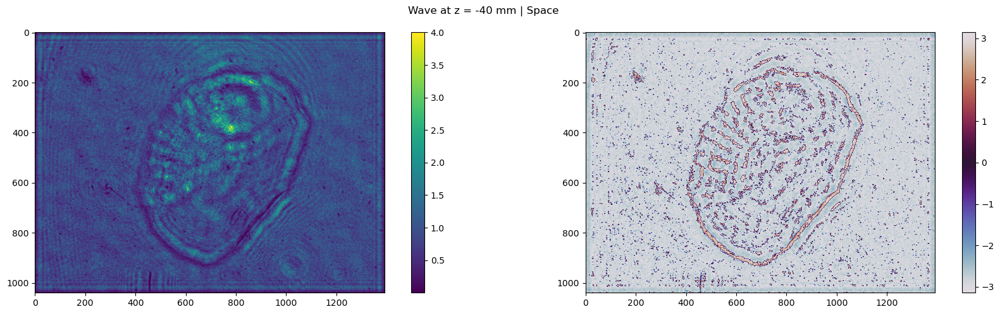

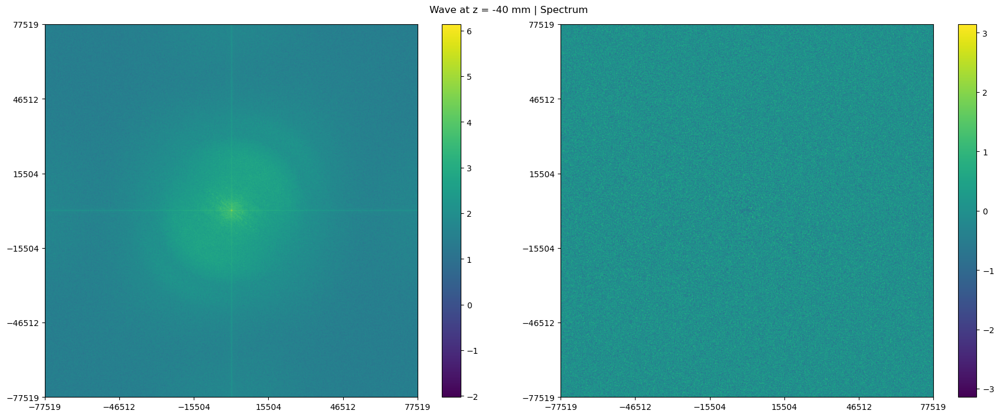

In [5]:
dist = -40 # mm

wave_z = wave_obj.propogate(dist)

fig, axs = plt.subplots(1, 2, figsize=(18, 5), tight_layout=True)
# cp_amp = axs[0].imshow(np.abs(wave_z)**2)
cp_amp = axs[0].imshow(np.clip((np.abs(wave_z)**2), 0, 4))
cp_ang = axs[1].imshow(((np.angle(wave_z))), cmap='twilight')

fig.colorbar(cp_amp, ax=axs[0])
fig.colorbar(cp_ang, ax=axs[1])
fig.suptitle(f'Wave at z = {dist} mm | Space')
plt.show()

fig, axs = plt.subplots(1, 2, figsize=(18, 7), tight_layout=True)

minFreqX, maxFreqX = -1/(2*wave_obj.sizePx[0]), 1/(2*wave_obj.sizePx[0])
minFreqY, maxFreqY = -1/(2*wave_obj.sizePx[1]), 1/(2*wave_obj.sizePx[1])

cp_amp = axs[0].imshow(np.log10(np.abs(wave_obj.fft_wave_z1)), 
                       extent=[minFreqX, maxFreqX, minFreqY, maxFreqY])

cp_ang = axs[1].imshow(np.angle(wave_obj.fft_wave_z1), 
                    #    cmap='twilight', 
                       extent=[minFreqX, maxFreqX, minFreqY, maxFreqY])

axs[0].set_xticks(np.linspace(minFreqX, maxFreqX, 6))
axs[0].set_yticks(np.linspace(minFreqY, maxFreqY, 6))

axs[1].set_xticks(np.linspace(minFreqX, maxFreqX, 6))
axs[1].set_yticks(np.linspace(minFreqY, maxFreqY, 6))

fig.colorbar(cp_amp, ax=axs[0])
fig.colorbar(cp_ang, ax=axs[1])

fig.suptitle(f'Wave at z = {dist} mm | Spectrum')
plt.show()

## Simulating Ground Truth: Object Plane Rotated by 30 degree around X axis

Translate by +/- 0.5914006932961915 at distance -39


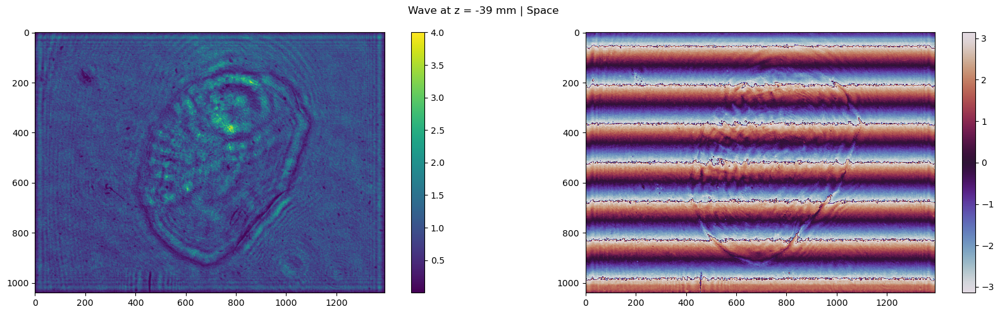

In [11]:
## GT simulation
rot_x = 10
dist = -39
translation = np.tan(rot_x/180 * np.pi)*3.354 # mm
print(f'Translate by +/- {translation} at distance {dist}')

# divide y axis into 260 steps === hstack 100 times with height 1040/260
steps = 260
wave_z_obl = []
for ind, dist2 in enumerate(np.linspace(dist + translation , dist - translation, steps)):
    wave_z_2 = wave_obj.propogate(dist2)
    wave_z_obl.append(wave_z_2[ind*int(1040/steps):(ind+1)*int(1040/steps), :])


wave_z_obl = np.vstack(np.array(wave_z_obl))

fig, axs = plt.subplots(1, 2, figsize=(18, 5), tight_layout=True)
# cp_amp = axs[0].imshow(np.abs(wave_z)**2)
cp_amp = axs[0].imshow(np.clip((np.abs(wave_z_obl)**2), 0, 4))
cp_ang = axs[1].imshow(((np.angle(wave_z_obl))), cmap='twilight')

fig.colorbar(cp_amp, ax=axs[0])
fig.colorbar(cp_ang, ax=axs[1])
fig.suptitle(f'Wave at z = {dist} mm | Space')
plt.show()

## Sample at Extremes of Translation

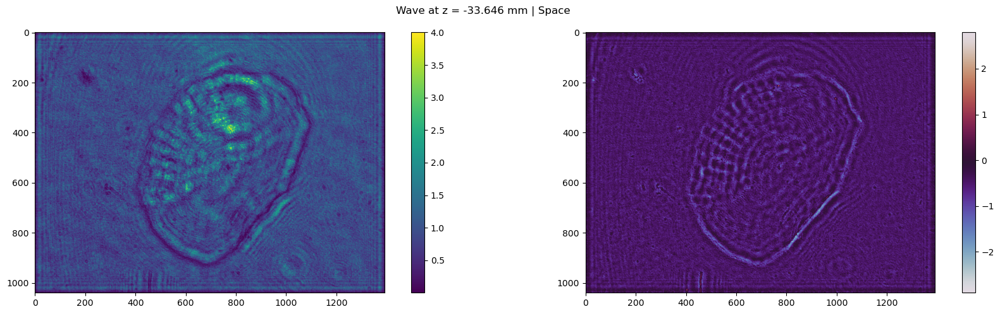

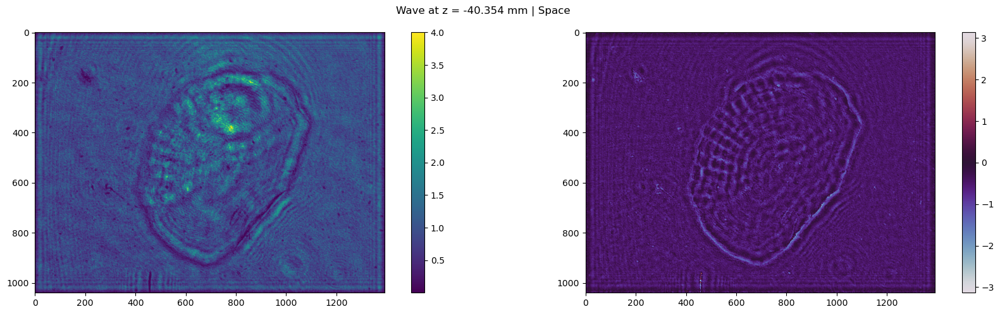

In [8]:
dist = -37 + translation # mm

wave_z = wave_obj.propogate(dist)

fig, axs = plt.subplots(1, 2, figsize=(18, 5), tight_layout=True)
# cp_amp = axs[0].imshow(np.abs(wave_z)**2)
cp_amp = axs[0].imshow(np.clip((np.abs(wave_z)**2), 0, 4))
cp_ang = axs[1].imshow(((np.angle(wave_z))), cmap='twilight')

fig.colorbar(cp_amp, ax=axs[0])
fig.colorbar(cp_ang, ax=axs[1])
fig.suptitle(f'Wave at z = {dist} mm | Space')
plt.show()

dist = -37 - translation # mm

wave_z = wave_obj.propogate(dist)

fig, axs = plt.subplots(1, 2, figsize=(18, 5), tight_layout=True)
# cp_amp = axs[0].imshow(np.abs(wave_z)**2)
cp_amp = axs[0].imshow(np.clip((np.abs(wave_z)**2), 0, 4))
cp_ang = axs[1].imshow(((np.angle(wave_z))), cmap='twilight')

fig.colorbar(cp_amp, ax=axs[0])
fig.colorbar(cp_ang, ax=axs[1])
fig.suptitle(f'Wave at z = {dist} mm | Space')
plt.show()

## Difference between Intensity of Image at {dist} and the Rotated Plane

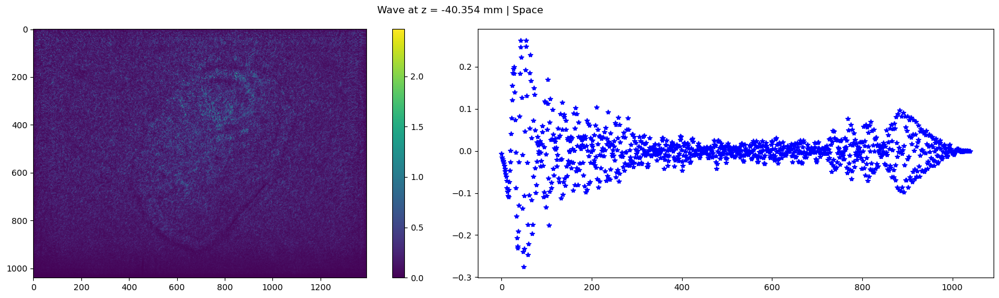

In [9]:
int_diff = wave_z - wave_z_obl

fig, axs = plt.subplots(1, 2, figsize=(18, 5), tight_layout=True)
# cp_amp = axs[0].imshow(np.abs(wave_z)**2)
cp_amp = axs[0].imshow(np.abs(np.abs(wave_z)**2 - np.abs(wave_z_obl)**2))
axs[1].plot(np.mean((np.abs(wave_z)**2 - np.abs(wave_z_obl)**2), axis=1), 'b*')
# axs[1].plot(np.abs((np.abs(wave_z)**2 - np.abs(wave_z_obl)**2))[:, 700], 'b*')

fig.colorbar(cp_amp, ax=axs[0])
fig.suptitle(f'Wave at z = {dist} mm | Space')
plt.show()

## Apply Tilt-Prop

In [487]:
dist = -40 # mm
angle = 15

wave_z = wave_obj.propogate(dist)

x_rot, y_rot = 0, angle
rot_plane = [(x_rot/180)*np.pi, (y_rot/180)*np.pi]
freqX, freqY, J = wave_obj.obliquePlaneFreqs(rot_plane)

Rotation aroud (X-axis, Y-axis): (0.0, 0.2617993877991494)


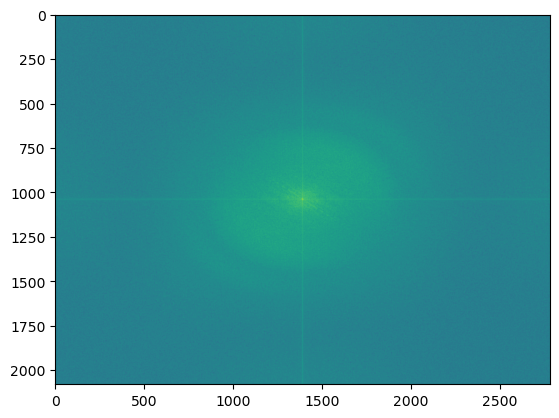

In [186]:
plt.imshow(np.log10(np.abs(wave_obj.fft_wave_z1*np.abs(J))))

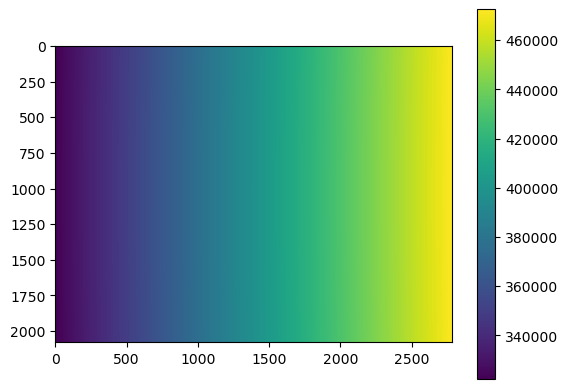

In [488]:
im0 = plt.imshow(freqX)
# fig, axs = plt.subplots(figsize=(10, 10))
# cp_amp = axs.imshow(np.log10(np.abs(wave_obj.fft_wave_z1)), 
                    #    extent=[freqX.min(), freqX.max(), freqY.min(), freqY.max()]
                     #   )

# axs.set_xticks(np.linspace(freqX.min(), freqX.max(), 7))
# axs.set_yticks(np.linspace(freqY.min(), freqY.max(), 7))

plt.colorbar(im0)

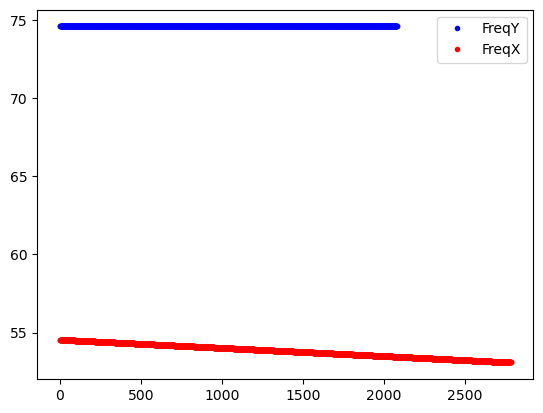

In [196]:
# change in frequencies across x and y with
# rotation aroung y, so no changes in FreqY
# as the FreqY grid is still uniform. However,
# FreqX grid is not uniform as the change in
# freq is reducing. Hence need to interpolate
# the grid by using the smallest change in freq
# as the diff across all adject nodes in specturm.

dist = -40 # mm
# angle = 30

diff = []
for i in range(len(freqY[:, 1500]) - 1):
    diff.append(freqY[i+1, 1500] - freqY[i, 1500])

plt.plot(diff, 'b.', label='FreqY')
# plt.show()

diff = []
for i in range(len(freqX[1000, :]) - 1):
    diff.append(freqX[1000, i+1] - freqX[1000, i])

plt.plot(diff, 'r.', label='FreqX')

plt.legend()

Rotation aroud (X-axis, Y-axis): (0.0, -1.0471975511965976)
Rotation aroud (X-axis, Y-axis): (0.0, -0.5235987755982988)
Rotation aroud (X-axis, Y-axis): (0.0, 0.0)
Rotation aroud (X-axis, Y-axis): (0.0, 0.5235987755982988)
Rotation aroud (X-axis, Y-axis): (0.0, 1.0471975511965976)


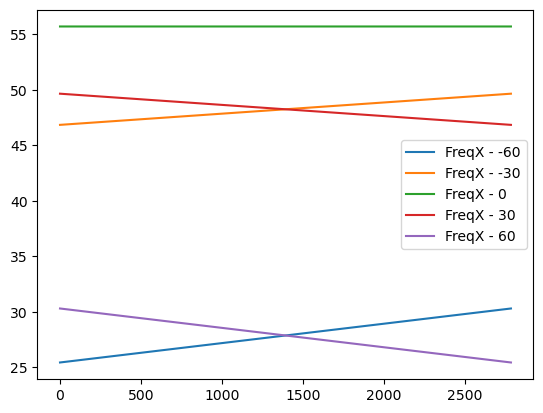

In [180]:
# change in FreqX wrt angles of rots

dist = -40 # mm

wave_z = wave_obj.propogate(dist)

for angle in [-60, -30, 0, 30, 60]:
    x_rot, y_rot = 0, angle
    rot_plane = [(x_rot/180)*np.pi, (y_rot/180)*np.pi]
    freqX, freqY, J = wave_obj.obliquePlaneFreqs(rot_plane)

    diff = []
    for i in range(len(freqX[1000, :]) - 1):
        diff.append(freqX[1000, i+1] - freqX[1000, i])

    plt.plot(diff, label=f'FreqX - {angle}')

plt.legend()

In [181]:
freqX.shape, freqY.shape

((2080, 2784), (2080, 2784))

Rotation aroud (X-axis, Y-axis): (0.0, 1.0471975511965976)


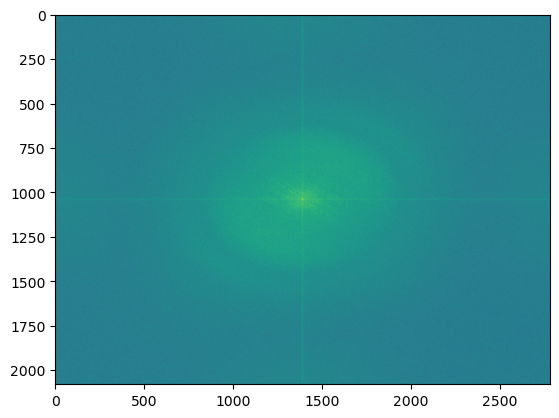

In [489]:
# steps to interpolation:
# use the min distance bw freq min(diff)
# as the standard difference and create
# a new uniform grid with the size that
# encompasses the max(freq) and min(freq)
# interpolate the freq coeffs accordingly

dist = -40 # mm
angle = 60

wave_z = wave_obj.propogate(dist)

x_rot, y_rot = 0, angle
rot_plane = [(x_rot/180)*np.pi, (y_rot/180)*np.pi]
freqX, freqY, J = wave_obj.obliquePlaneFreqs(rot_plane)

plt.imshow(np.log10(np.abs(wave_obj.fft_wave_z1*np.abs(J))))

diff = []
for i in range(len(freqX[1000, :]) - 1):
    diff.append(freqX[1000, i+1] - freqX[1000, i])
    
x = freqX.ravel()
y = freqY.ravel()
z = (wave_obj.fft_wave_z1*J).ravel()

In [490]:

xy = np.c_[x, y]   # or just list(zip(x, y))

# lut2 = LinearNDInterpolator(xy, z)
lut_amp = CloughTocher2DInterpolator(xy, np.abs(z))
lut_ang = CloughTocher2DInterpolator(xy, np.angle(z))

In [491]:
step = int((max(x) - min(x))/np.max(diff)) # can also use max, or w/o rotation as that del is always higher than rotation dels
X = np.linspace(min(x), max(x), step-1)
# Y = np.linspace(min(y), max(y), step)
X, Y = np.meshgrid(X, freqY[:, 0])

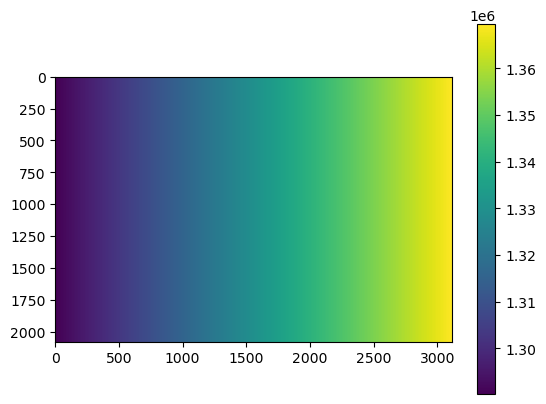

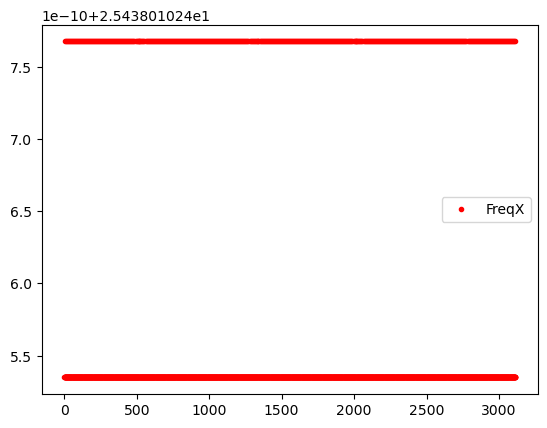

In [353]:
plt.imshow(X)
plt.colorbar()
plt.show()

diff = []
for i in range(len(X[1000, :]) - 1):
    diff.append(X[1000, i+1] - X[1000, i])

plt.plot(diff, 'r.', label='FreqX')

plt.legend()

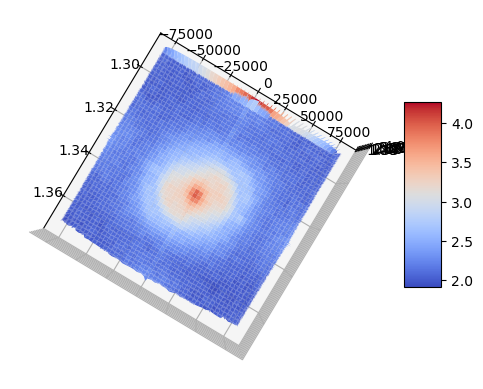

In [492]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')

# ax.plot_wireframe(X, Y, np.log10(np.abs(lut2(X, Y))))
# ax.scatter(x, y, z,  'o', color='k', s=48)

# ax.contour(X, Y, np.log10(np.abs(lut2(X, Y))), extend3d=True, cmap=cm.coolwarm)
surf = ax.plot_surface(X, Y, np.log10(np.abs(lut_amp(X, Y))), cmap=cm.coolwarm,
                       linewidth=0, antialiased=True)

# Customize the z axis.
from matplotlib.ticker import LinearLocator
ax.set_zlim(1, 4)
ax.zaxis.set_major_locator(LinearLocator(10))
# A StrMethodFormatter is used automatically
ax.zaxis.set_major_formatter('{x:.02f}')
ax.view_init(elev=90, azim=30, roll=0)

fig.colorbar(surf, shrink=0.5, aspect=5)

In [493]:
Z = lut_amp(X, Y)

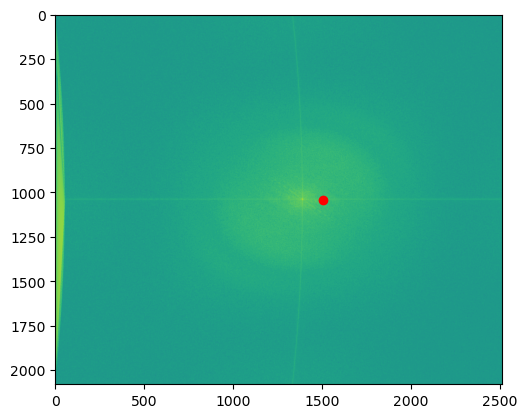

In [494]:
plt.imshow(np.log10(np.abs(Z))[:, :-100])
plt.scatter(1507, 1040, color='red')
# plt.imshow(np.angle(Z))
# plt.colorbar()

# plt.pcolormesh(X, Y, np.log10(np.abs(Z)), shading='auto')

In [495]:
Z[:, :-100].shape, Z[:, :-100]

((2080, 2514),
 array([[120.12120806,  72.41776168,  28.32500609, ..., 168.0377824 ,
         218.51974644,  97.84233931],
        [140.19427525,  85.97972832,  99.35448059, ..., 196.14103253,
         112.07442823,  30.28161227],
        [160.2208427 ,  68.56573509,  79.04511101, ..., 164.77487914,
          40.44671355, 170.1550838 ],
        ...,
        [168.62604109, 127.64779385,  93.18186363, ..., 217.78760408,
         276.40793693, 233.67845207],
        [176.85180068, 199.58842286, 113.77819591, ..., 212.68317291,
         106.22765514, 121.20404284],
        [185.11269122, 167.9830544 ,  72.53997677, ...,  60.83744867,
         148.00144926,  88.19628426]]))

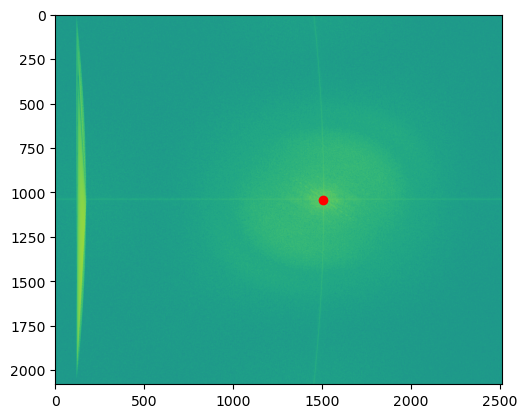

In [503]:
plt.imshow(np.roll(np.log10(np.abs(Z))[:, :-100], 120, axis=1))
plt.scatter(1507, 1040, color='red')

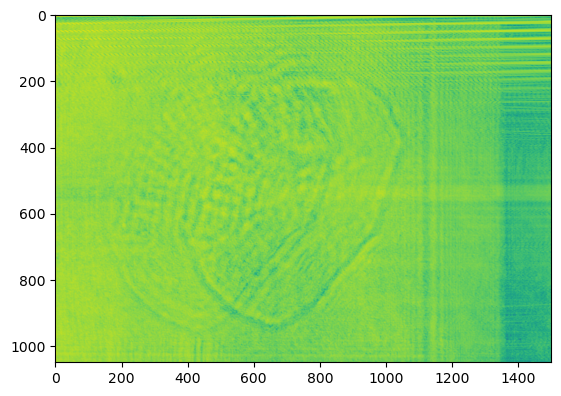

In [497]:
wave_rot_plane = np.fft.ifft2(np.fft.fftshift(lut_amp(X, Y)[:, :-100]*np.exp(1j*lut_ang(X, Y)[:, :-100])))[500:1550, 700:2200]

plt.imshow(np.log10(np.abs(wave_rot_plane)))

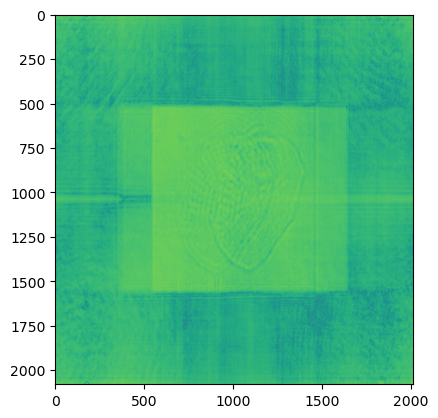

In [502]:
wave_rot_plane = np.fft.ifft2(np.fft.fftshift(np.roll(lut_amp(X, Y)[:, :-100], 110, axis=1)[:, 500:]*np.exp(1j*np.roll(lut_ang(X, Y)[:, :-100], 110, axis=1)[:, 500:])))
# [500:1550, 700:2200]

plt.imshow(np.log10(np.abs(wave_rot_plane)))

In [386]:
wave_rot_plane.shape, wave_rot_plane

((1100, 1600),
 array([[-1.22455241-0.26234787j, -1.63533648-1.10289009j,
         -0.74966748-0.98412855j, ..., -3.82614893-0.47774983j,
          3.30551858+1.45568646j, -3.62659694-1.25735298j],
        [-2.41346793-0.50811815j, -0.39804297-0.72692027j,
         -1.76057308-1.46207084j, ..., -3.43679812-2.05570477j,
          2.97918807+2.94330961j, -2.99646327-2.60811345j],
        [-3.40411196-0.73748574j,  0.677134  -0.24646464j,
         -2.69618651-2.03046782j, ..., -2.04024648-2.22356869j,
          2.31266459+2.9303705j , -1.55710263-2.29163142j],
        ...,
        [-1.10503826-0.16462304j, -0.5554376 -0.56273875j,
         -0.53016059-0.68988907j, ...,  0.05366481+0.88126863j,
          0.48556905-0.27479114j, -0.06112762+1.22864959j],
        [-1.02601103-0.14403625j, -0.98647233-0.9410554j ,
         -0.49283744-0.55017204j, ...,  0.56885689+0.52663526j,
         -0.01413112-0.04155731j,  0.66348407+0.4856772j ],
        [-0.35334027-0.78332925j, -1.64832896-0.33923141j

## Apply to synthetic signal for validation of method implementation

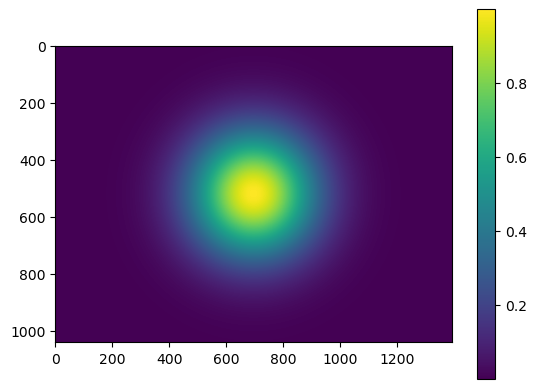

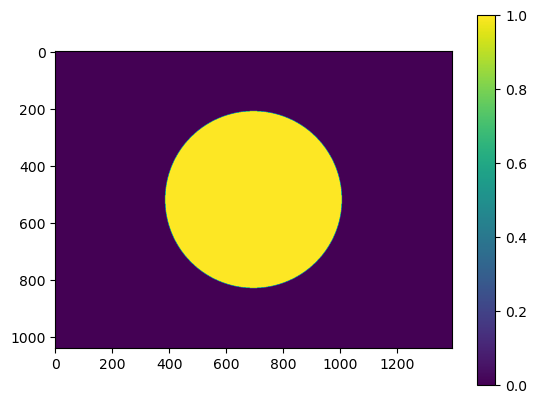

In [514]:
# 2d gaussian intensity and unifrom phase as synthetic input

numPx = [1392, 1040]
sizePx = [0.00645, 0.00645]

# Generating 2D grids 'x' and 'y' using meshgrid with 10 evenly spaced points from -1 to 1
x, y = np.meshgrid(np.linspace(-1*numPx[0]*sizePx[0]/2, 1*numPx[0]*sizePx[0]/2, numPx[0]), 
                   np.linspace(-1*numPx[1]*sizePx[1]/2, 1*numPx[1]*sizePx[1]/2, numPx[1]))

# Calculating the Euclidean distance 'd' from the origin using the generated grids 'x' and 'y'
d = np.sqrt(x*x + y*y)

# Defining parameters sigma and mu for a Gaussian-like distribution
sigma, mu = 1.0, 0.0

# Calculating the Gaussian-like distribution 'g' based on the distance 'd', sigma, and mu
g_int = np.exp(-((d - mu)**2 / (2.0 * sigma**2)))

plt.imshow(g_int)
plt.colorbar()
plt.show()

g_phase = d < 2
plt.imshow(g_phase)
plt.colorbar()

In [515]:
gaussian_parax = g_int*np.exp(1j*g_phase*1e-6)
gaussian_parax.dtype

dtype('complex128')

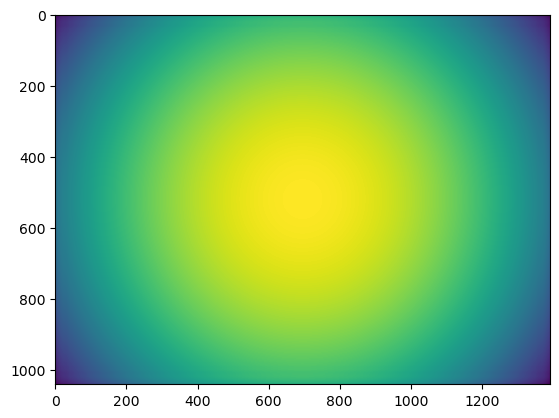

In [523]:
gaussian_parax = g_int*np.exp(1j*g_phase*1e-6)

wave_gauss = Wave2d(
    numPx = [1392, 1040], 
    sizePx = [0.00645, 0.00645], 
    wl = 650*1e-6
    # wl = 532.8*1e-6
    )

wave_gauss.wavefield(gaussian_parax)

dist = 40 # mm

wave_z = wave_gauss.propogate(dist)

plt.imshow(np.log10(np.abs(wave_z)))

Rotation aroud (X-axis, Y-axis): (0.0, 1.0471975511965976)


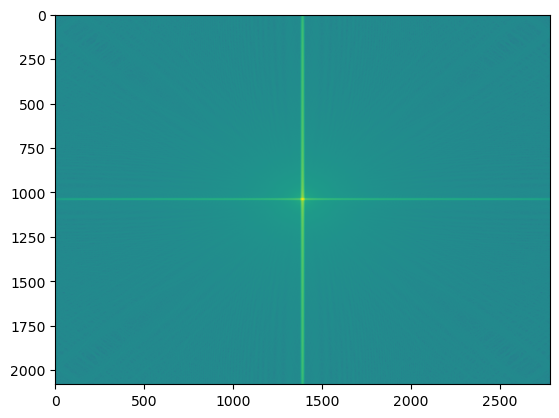

In [524]:
angle = 60

x_rot, y_rot = 0, angle
rot_plane = [(x_rot/180)*np.pi, (y_rot/180)*np.pi]
freqX, freqY, J = wave_gauss.obliquePlaneFreqs(rot_plane)

plt.imshow(np.log10(np.abs(wave_gauss.fft_wave_z1*np.abs(J))))

diff = []
for i in range(len(freqX[1000, :]) - 1):
    diff.append(freqX[1000, i+1] - freqX[1000, i])
    
x = freqX.ravel()
y = freqY.ravel()
z = (wave_gauss.fft_wave_z1*J).ravel()

In [525]:
xy = np.c_[x, y]   # or just list(zip(x, y))

# lut2 = LinearNDInterpolator(xy, z)
lut_amp = CloughTocher2DInterpolator(xy, np.abs(z))
lut_ang = CloughTocher2DInterpolator(xy, np.angle(z))

step = int((max(x) - min(x))/np.max(diff)) # can also use max, or w/o rotation as that del is always higher than rotation dels
X = np.linspace(min(x), max(x), step-1)
# Y = np.linspace(min(y), max(y), step)
X, Y = np.meshgrid(X, freqY[:, 0])

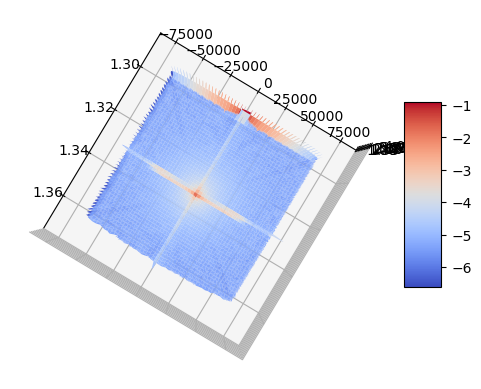

In [526]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')

# ax.plot_wireframe(X, Y, np.log10(np.abs(lut2(X, Y))))
# ax.scatter(x, y, z,  'o', color='k', s=48)

# ax.contour(X, Y, np.log10(np.abs(lut2(X, Y))), extend3d=True, cmap=cm.coolwarm)
surf = ax.plot_surface(X, Y, np.log10(np.abs(lut_amp(X, Y))), cmap=cm.coolwarm,
                       linewidth=0, antialiased=True)

# Customize the z axis.
from matplotlib.ticker import LinearLocator
ax.set_zlim(1, 4)
ax.zaxis.set_major_locator(LinearLocator(10))
# A StrMethodFormatter is used automatically
ax.zaxis.set_major_formatter('{x:.02f}')
ax.view_init(elev=90, azim=30, roll=0)

fig.colorbar(surf, shrink=0.5, aspect=5)

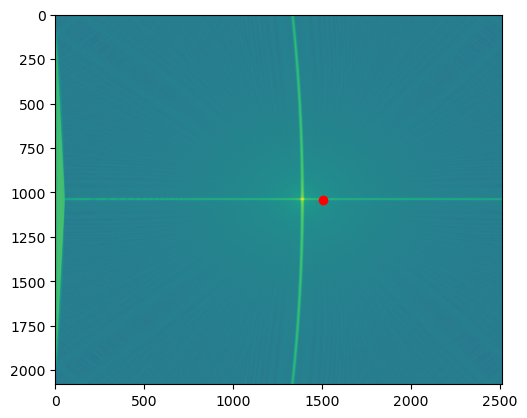

In [531]:
Z = lut_amp(X, Y)
plt.imshow(np.roll(np.log10(np.abs(Z))[:, :-100], 120, axis=1)[:, :])
plt.scatter(1507, 1040, color='red')

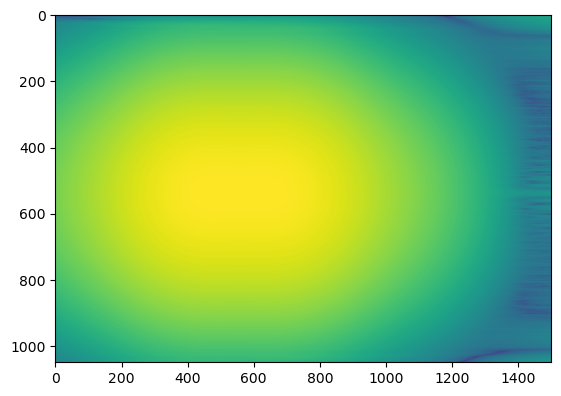

In [528]:
wave_rot_plane = np.fft.ifft2(np.fft.fftshift(lut_amp(X, Y)[:, :-100]*np.exp(1j*lut_ang(X, Y)[:, :-100])))[500:1550, 700:2200]

plt.imshow(np.log10(np.abs(wave_rot_plane)))

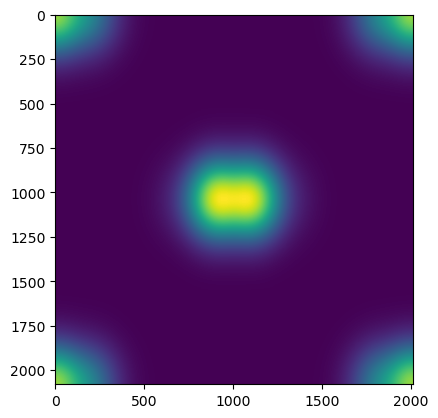

In [529]:
wave_rot_plane = np.fft.ifft2(np.fft.fftshift(np.roll(lut_amp(X, Y)[:, :-100], 140, axis=1)[:, 500:]*np.exp(1j*np.roll(lut_ang(X, Y)[:, :-100], 140, axis=1)[:, 500:])))
# [500:1550, 700:2200]

plt.imshow((np.abs(wave_rot_plane)))

## Understanding the Change in Frequency Bins and Interpolation to Get Equidistant Grid

Rotation aroud (X-axis, Y-axis): (0.0, 0.0)
0: -77519.37984496124, -77519.37984496124, 77519.37984496124, 77519.37984496124
Rotation aroud (X-axis, Y-axis): (-0.017453292519943295, 0.0)
1: -77519.37984496124, -50725.97333485854, 77519.37984496124, 104323.32297593307
Rotation aroud (X-axis, Y-axis): (0.03490658503988659, 0.0)
2: -77519.37984496124, -131095.48821212372, 77519.37984496124, 23917.11520188451
Rotation aroud (X-axis, Y-axis): (0.2617993877991494, 0.0)
3: -77519.37984496124, -472555.3204588819, 77519.37984496124, -322292.9375151078


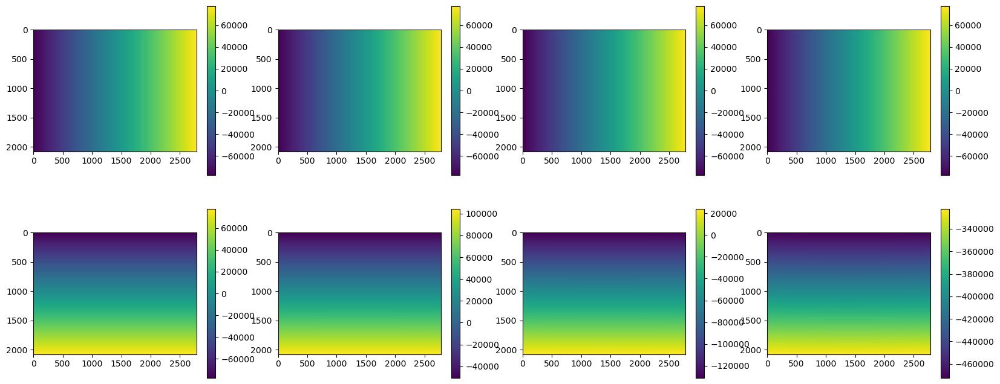

In [10]:
fig, axs = plt.subplots(2, 4, figsize=(20, 8))

for i, angle in enumerate([0, -1, 2, 15]):
    x_rot, y_rot = angle, 0
    rot_plane = [(x_rot/180)*np.pi, (y_rot/180)*np.pi]
    a, b = wave_obj.obliquePlaneFreqs(rot_plane)
    
    print(f'{i}: {np.min(a)}, {b.min()}, {a.max()}, {b.max()}')

    im0 = axs[0, i].imshow(a)
    plt.colorbar(im0, ax=axs[0, i])

    im1 = axs[1, i].imshow(b)
    plt.colorbar(im1, ax=axs[1, i])
plt.show()

Rotation aroud (X-axis, Y-axis): (-0.7853981633974483, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.767944870877505, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.7504915783575618, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.7330382858376184, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.7155849933176751, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.6981317007977318, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.6806784082777886, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.6632251157578453, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.6457718232379019, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.6283185307179586, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.6108652381980153, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.593411945678072, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.5759586531581287, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.5585053606381855, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.5410520681182421, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.5235987755982988, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.50614

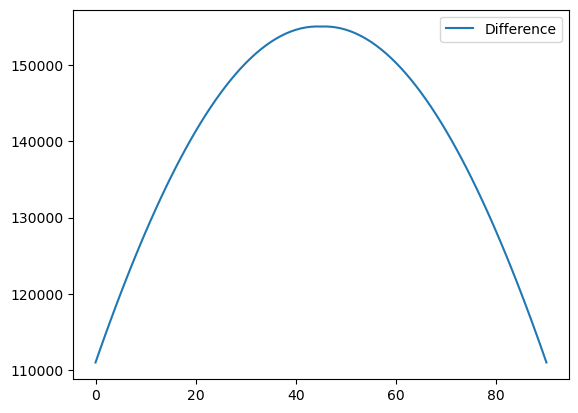

In [163]:
ang_freq_max = []
ang_freq_min = []

for i, angle in enumerate(np.linspace(-45, 45, 91)):
    x_rot, y_rot = angle, 0
    rot_plane = [(x_rot/180)*np.pi, (y_rot/180)*np.pi]
    a, b = wave_obj.obliquePlaneFreqs(rot_plane)

    ang_freq_max.append(b.max())
    ang_freq_min.append(b.min())

# plt.plot(ang_freq_max, label='Max')
# plt.plot(ang_freq_min, label='Min')
plt.plot(np.array(ang_freq_max) - np.array(ang_freq_min), label='Difference')
plt.legend()

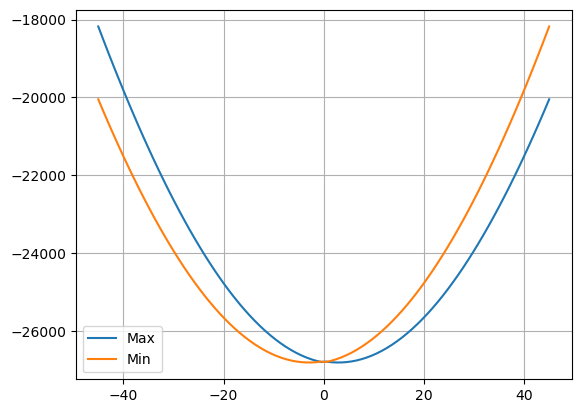

In [167]:
plt.plot(np.linspace(-45, 45, 90), np.ediff1d(ang_freq_max), label='Max')
plt.plot(np.linspace(-45, 45, 90), np.ediff1d(ang_freq_min), label='Min')
plt.legend()
plt.grid()

Rotation aroud (X-axis, Y-axis): (0.0, 0.0)
Rotation aroud (X-axis, Y-axis): (0.2617993877991494, 0.0)


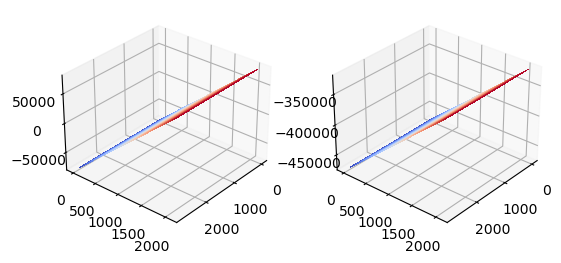

In [165]:
X = np.arange(0, b.shape[1])
Y = np.arange(0, b.shape[0])
X, Y = np.meshgrid(X, Y)

from matplotlib import cm
fig, ax = plt.subplots(1, 2, subplot_kw={"projection": "3d"})

for i, angle in enumerate([0, 15]):
    x_rot, y_rot = angle, 0
    rot_plane = [(x_rot/180)*np.pi, (y_rot/180)*np.pi]
    a, b = wave_obj.obliquePlaneFreqs(rot_plane)

    ax[i].plot_surface(X, Y, b, cmap=cm.coolwarm,
                        linewidth=0, antialiased=False, label=angle)
    ax[i].view_init(elev=30, azim=40, roll=0)


In [65]:
# 1- for a single rotation, it seems that the bins are linearly shifted.
# that is, grid for freqs linear spaced stil. (wrong)
# 2- caomparing different rotations, the total frequencies (max - mib) is
# different for diff. rotation angles, with the difference decreasing for
# increasing angles. (correct)

## To-do
# Select min-max angle of rotations and intermediate overlapping freq steps
# Interpolate each frequency patch to match the base (no rotation) since the
# resolution on the base patch was calculated based on the hardware.

# The range of frequencies in the same size fourier plane decreases with 
# increasing rotation. This should suggest that the freq. resolution is
# decreasing.
# If we were to augment the frequency space with unprocessed patches, this
# would mean that we would not have equidistant grid points.
# To retain an equidistant grid, we can reduce the size of torated patch while
# not reducing max/min frequencies captures, hence interpolation. (also why)

((2080, 2784),
 (2080, 2784),
 70822.92324462716,
 -84222.89843814034,
 240.60971481753253,
 dtype('float64'))

In [137]:
dist = -40 # mm
angle = 3


wave_z = wave_obj.propogate(dist)

x_rot, y_rot = angle, 0
rot_plane = [(x_rot/180)*np.pi, (y_rot/180)*np.pi]
a, b = wave_obj.obliquePlaneFreqs(rot_plane)

wave_fft_offset = np.zeros([2080 + np.abs(int((np.abs(a.min()) - a.max())*2080/(a.max() - a.min()))), 
                            2784 + np.abs(int((np.abs(b.min()) - b.max())*2784/(b.max() - b.min())))], dtype=np.complex128)

wave_fft_offset[np.abs(int((np.abs(a.min()) - a.max())*2080/(a.max() - a.min()))):, 
                np.abs(int((np.abs(b.min()) - b.max())*2784/(b.max() - b.min()))):] = wave_obj.fft_wave_z1

Rotation aroud (X-axis, Y-axis): (0.05235987755982988, 0.0)


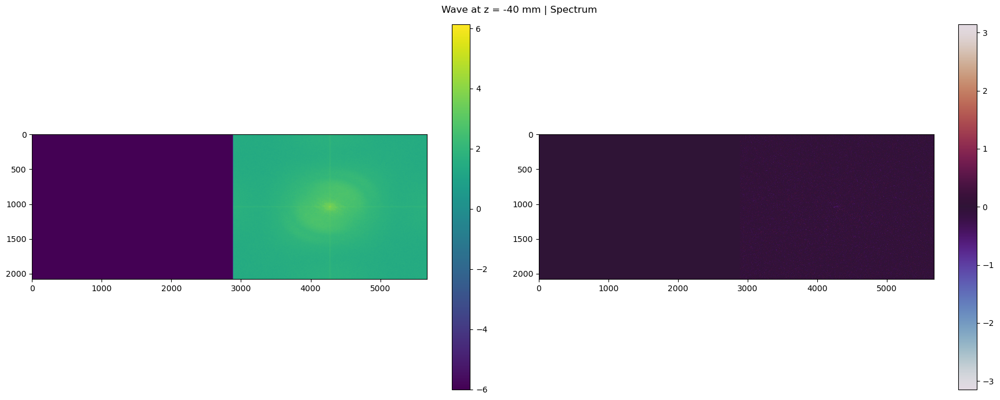

In [138]:
fig, axs = plt.subplots(1, 2, figsize=(18, 7), tight_layout=True)

cp_amp = axs[0].imshow(np.log10(np.abs(wave_fft_offset) + 0.000001), 
                    #    extent=[-1/(2*wave_obj.sizePx[0]), 1/(2*wave_obj.sizePx[0]), -1/(2*wave_obj.sizePx[1]), 1/(2*wave_obj.sizePx[1])]
                       )

cp_ang = axs[1].imshow(np.angle(wave_fft_offset), cmap='twilight', 
                    #    extent=[-1/(2*wave_obj.sizePx[0]), 1/(2*wave_obj.sizePx[0]), -1/(2*wave_obj.sizePx[1]), 1/(2*wave_obj.sizePx[1])]
                       )

# axs[0].set_xticks(np.linspace(-1/(2*wave_obj.sizePx[0]), 1/(2*wave_obj.sizePx[0]), 6))
# axs[0].set_yticks(np.linspace(-1/(2*wave_obj.sizePx[1]), 1/(2*wave_obj.sizePx[1]), 6))

# axs[1].set_xticks(np.linspace(-1/(2*wave_obj.sizePx[0]), 1/(2*wave_obj.sizePx[0]), 6))
# axs[1].set_yticks(np.linspace(-1/(2*wave_obj.sizePx[1]), 1/(2*wave_obj.sizePx[1]), 6))

fig.colorbar(cp_amp, ax=axs[0])
fig.colorbar(cp_ang, ax=axs[1])

fig.suptitle(f'Wave at z = {dist} mm | Spectrum')
plt.show()

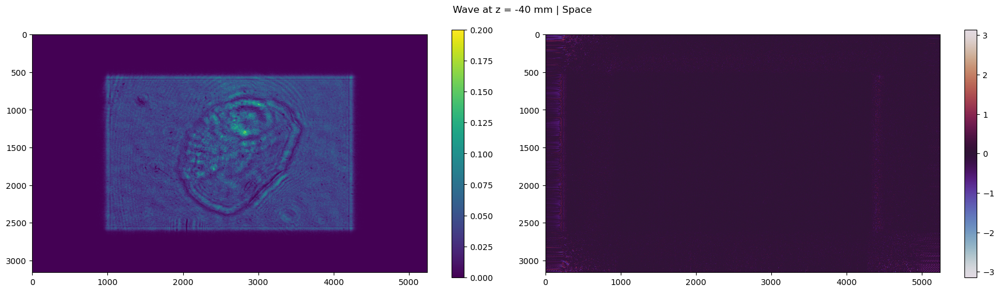

In [44]:
wave_offset = np.fft.ifft2(np.fft.fftshift(wave_fft_offset))[500:-500, 700:-700]
# [700:-700, 700:-700]

fig, axs = plt.subplots(1, 2, figsize=(18, 5), tight_layout=True)

cp_amp = axs[0].imshow(np.clip((np.abs(wave_offset)**2), 0, 4))
cp_ang = axs[1].imshow(((np.angle(wave_offset))), cmap='twilight')

fig.colorbar(cp_amp, ax=axs[0])
fig.colorbar(cp_ang, ax=axs[1])
fig.suptitle(f'Wave at z = {dist} mm | Space')
# plt.tight_layout()
plt.show()

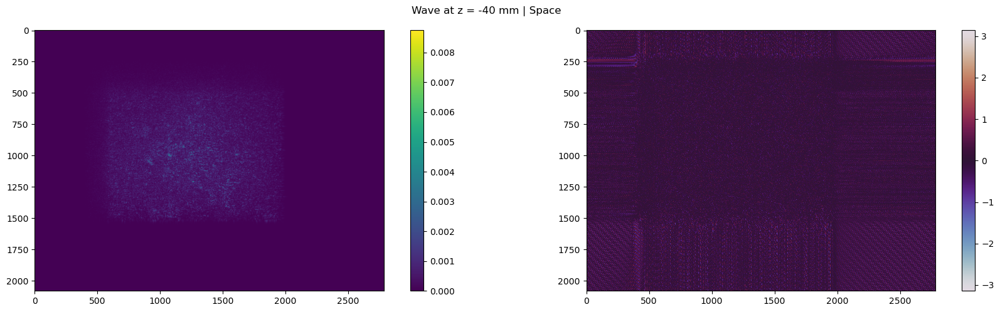

C:\Users\Kazim\AppData\Local\Temp\ipykernel_5768\2819714562.py:23: RuntimeWarning: divide by zero encountered in log10
  cp_amp = axs[0].imshow(np.log10(np.abs(fft_crop)),


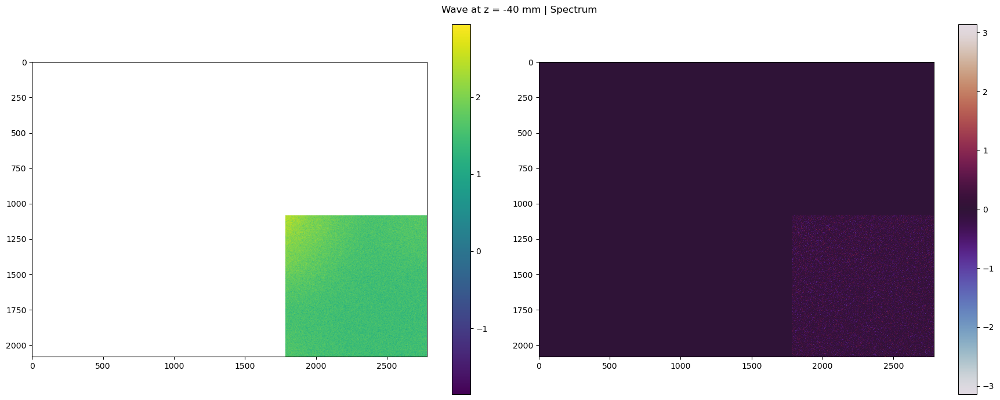

In [80]:
dist = -40 # mm

wave_z = wave_obj.propogate(dist)

fft_crop = np.zeros_like(wave_obj.fft_wave_z1)
fft_crop[-1000:, -1000:]= wave_obj.fft_wave_z1[-1000:, -1000:]
# fft_crop = wave_obj.fft_wave_z1[-1000:, -1000:]

wave_fft_crop = np.fft.ifft2(np.fft.fftshift(fft_crop))

fig, axs = plt.subplots(1, 2, figsize=(18, 5), tight_layout=True)

cp_amp = axs[0].imshow(np.clip((np.abs(wave_fft_crop)**2), 0, 4))
cp_ang = axs[1].imshow(((np.angle(wave_fft_crop))), cmap='twilight')

fig.colorbar(cp_amp, ax=axs[0])
fig.colorbar(cp_ang, ax=axs[1])
fig.suptitle(f'Wave at z = {dist} mm | Space')
plt.show()

fig, axs = plt.subplots(1, 2, figsize=(18, 7), tight_layout=True)

cp_amp = axs[0].imshow(np.log10(np.abs(fft_crop)), 
                    #    extent=[-1/(2*wave_obj.sizePx[0]), 1/(2*wave_obj.sizePx[0]), -1/(2*wave_obj.sizePx[1]), 1/(2*wave_obj.sizePx[1])]
                       )

cp_ang = axs[1].imshow(np.angle(fft_crop), cmap='twilight', 
                    #    extent=[-1/(2*wave_obj.sizePx[0]), 1/(2*wave_obj.sizePx[0]), -1/(2*wave_obj.sizePx[1]), 1/(2*wave_obj.sizePx[1])]
                       )

# axs[0].set_xticks(np.linspace(-1/(2*wave_obj.sizePx[0]), 1/(2*wave_obj.sizePx[0]), 6))
# axs[0].set_yticks(np.linspace(-1/(2*wave_obj.sizePx[1]), 1/(2*wave_obj.sizePx[1]), 6))

# axs[1].set_xticks(np.linspace(-1/(2*wave_obj.sizePx[0]), 1/(2*wave_obj.sizePx[0]), 6))
# axs[1].set_yticks(np.linspace(-1/(2*wave_obj.sizePx[1]), 1/(2*wave_obj.sizePx[1]), 6))

fig.colorbar(cp_amp, ax=axs[0])
fig.colorbar(cp_ang, ax=axs[1])

fig.suptitle(f'Wave at z = {dist} mm | Spectrum')
plt.show()

In [10]:
for angle in np.linspace(-2, 2, 41):

    x_rot, y_rot = angle, 0
    rot_plane = [(x_rot/180)*np.pi, (y_rot/180)*np.pi]
    a, b = wave_obj.obliquePlaneFreqs(rot_plane)
    # a = np.abs(a)
    a = (a - a.min())/(a.max() - a.min())
    cv2.imshow('Frame', cv2.resize(a, (800, 600)))

    # add waitKey for video to display
    key = cv2.waitKey(1)

    if key == ord('q'):
        # do not close window, you want to show the frame
        cv2.destroyAllWindows()
        break

cv2.destroyAllWindows()

Rotation aroud (X-axis, Y-axis): (-0.03490658503988659, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.03316125578789226, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.031415926535897934, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.029670597283903602, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.027925268031909273, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.02617993877991494, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.024434609527920613, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.02268928027592628, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.020943951023931952, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.019198621771937624, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.017453292519943295, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.015707963267948963, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.013962634015954633, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.012217304763960306, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.010471975511965975, 0.0)
Rotation aroud (X-axis, Y-axis): (-0.008726646259971648, 0.0)
Rotation aro

In [11]:
wave_obj.u.shape, wave_obj.v.shape

((2080, 2784), (2080, 2784))

In [12]:
wave_obj.u[:3, :3], wave_obj.v[:3, :3]

(array([[-77519.37984496, -77463.67062481, -77407.96140465],
        [-77519.37984496, -77463.67062481, -77407.96140465],
        [-77519.37984496, -77463.67062481, -77407.96140465]]),
 array([[-77519.37984496, -77519.37984496, -77519.37984496],
        [-77444.80612698, -77444.80612698, -77444.80612698],
        [-77370.23240899, -77370.23240899, -77370.23240899]]))

Rotation aroud (X-axis, Y-axis): (0.17453292519943295, 0.17453292519943295)
-77519.37984496124 77519.37984496124 -343153.3770516858 -190130.22062268484
155038.75968992247 153023.15642900098


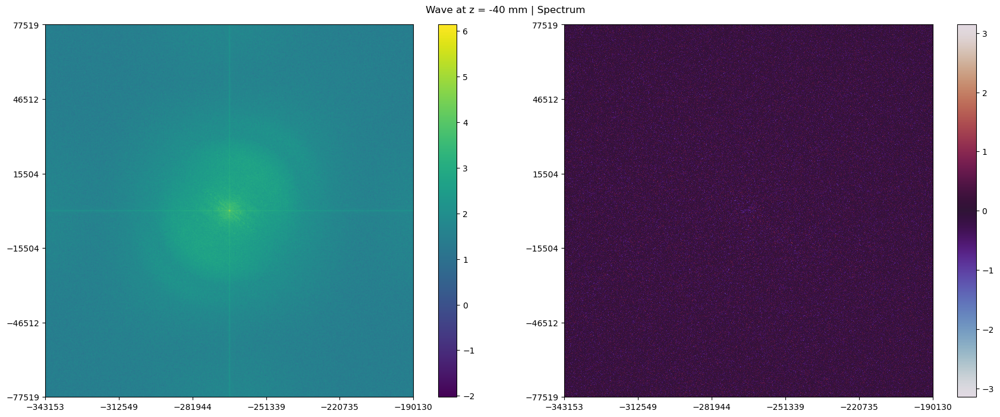

In [13]:
x_rot, y_rot = 10, 10
rot_plane = [(x_rot/180)*np.pi, (y_rot/180)*np.pi]
[freq_rows_obl, freq_cols_obl] = wave_obj.obliquePlaneFreqs(rot_plane)

print(np.min(freq_rows_obl), np.max(freq_rows_obl), np.min(freq_cols_obl), np.max(freq_cols_obl))
print(np.abs(np.min(freq_rows_obl) - np.max(freq_rows_obl)), np.abs(np.min(freq_cols_obl) - np.max(freq_cols_obl)))

fig, axs = plt.subplots(1, 2, figsize=(18, 7), tight_layout=True)

cp_amp = axs[0].imshow(np.log10(np.abs(wave_obj.fft_wave_z1)), 
                       extent=[np.min(freq_cols_obl), np.max(freq_cols_obl), np.min(freq_rows_obl), np.max(freq_rows_obl)])

cp_ang = axs[1].imshow(np.angle(wave_obj.fft_wave_z1), cmap='twilight', 
                       extent=[np.min(freq_cols_obl), np.max(freq_cols_obl), np.min(freq_rows_obl), np.max(freq_rows_obl)])

axs[0].set_yticks(np.linspace(np.min(freq_rows_obl), np.max(freq_rows_obl), 6))
axs[0].set_xticks(np.linspace(np.min(freq_cols_obl), np.max(freq_cols_obl), 6))

axs[1].set_yticks(np.linspace(np.min(freq_rows_obl), np.max(freq_rows_obl), 6))
axs[1].set_xticks(np.linspace(np.min(freq_cols_obl), np.max(freq_cols_obl), 6))

fig.colorbar(cp_amp, ax=axs[0])
fig.colorbar(cp_ang, ax=axs[1])

fig.suptitle(f'Wave at z = {dist} mm | Spectrum')
plt.show()

Rotation aroud (X-axis, Y-axis): (0.17453292519943295, 0.0)
-77519.37984496124 77519.37984496124 -343153.3770516858 -190130.22062268484
155038.75968992247 153023.15642900098


C:\Users\Kazim\AppData\Local\Temp\ipykernel_14872\2189929951.py:9: UserWarning: The input coordinates to pcolor are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolor.
  plt.pcolor(freq_cols_obl, freq_rows_obl, np.log10(np.abs(wave_obj.fft_wave_z1)))


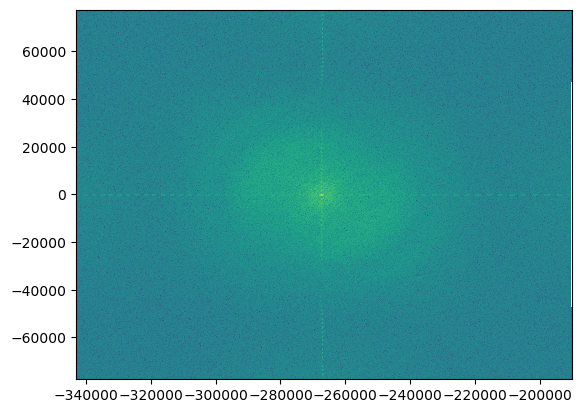

In [14]:
x_rot, y_rot = 10, 0
rot_plane = [(x_rot/180)*np.pi, (y_rot/180)*np.pi]
[freq_rows_obl, freq_cols_obl] = wave_obj.obliquePlaneFreqs(rot_plane)

print(np.min(freq_rows_obl), np.max(freq_rows_obl), np.min(freq_cols_obl), np.max(freq_cols_obl))
print(np.abs(np.min(freq_rows_obl) - np.max(freq_rows_obl)), np.abs(np.min(freq_cols_obl) - np.max(freq_cols_obl)))


plt.pcolor(freq_cols_obl, freq_rows_obl, np.log10(np.abs(wave_obj.fft_wave_z1)))

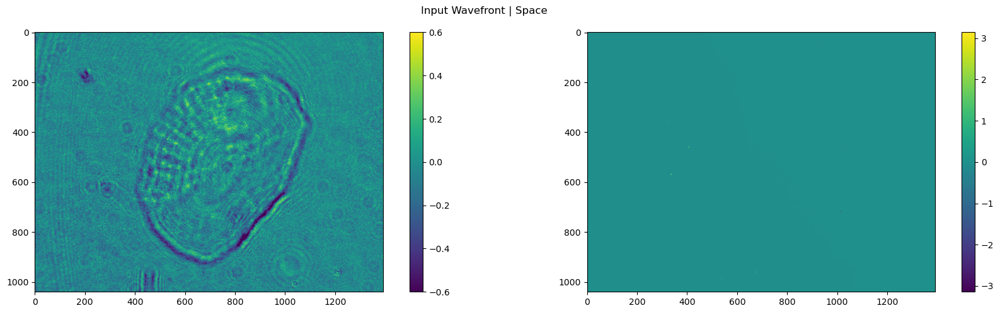

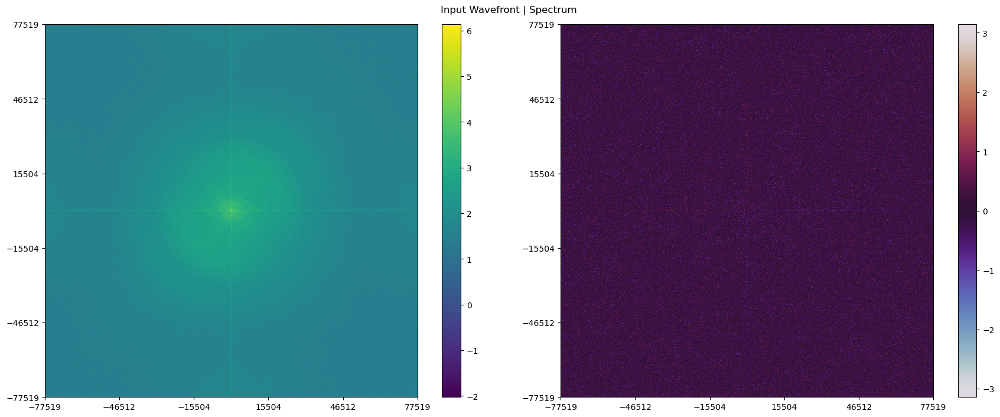

In [15]:
sample = '05_02'
sample_name = f'samples/2024_01_30_Wolfgangs_Wavefront_Sensor_First_Test/Reconstruction/{sample}.mat'
 
A = np.array(h5py.File(sample_name, 'r').get('A'))
P = np.array(h5py.File(sample_name, 'r').get('phi'))*1e-6

wave_0= A*np.exp(1j*P)
wave_0 = wave_0.T

wave_obj = Wave2d(
    numPx = [1392, 1040], 
    sizePx = [0.00645, 0.00645], 
    wl = 650*1e-6
    # wl = 532.8*1e-6
    )

wave_obj.wavefield(wave_0)

fig, axs = plt.subplots(1, 2, figsize=(18, 5), tight_layout=True)
cp_amp = axs[0].imshow(np.log10(np.abs(wave_obj.wavefield_z0)), vmax=0.6, vmin=-0.6)
cp_ang = axs[1].imshow((np.angle(wave_obj.wavefield_z0)))

fig.colorbar(cp_amp, ax=axs[0])
fig.colorbar(cp_ang, ax=axs[1])
fig.suptitle('Input Wavefront | Space')
plt.show()

fig, axs = plt.subplots(1, 2, figsize=(18, 7), tight_layout=True)

cp_amp = axs[0].imshow(np.log10(np.abs(wave_obj.fft_wave_z0)), 
                       extent=[np.min(wave_obj.v), np.max(wave_obj.v), np.min(wave_obj.u), np.max(wave_obj.u)])

cp_ang = axs[1].imshow(np.angle(wave_obj.fft_wave_z0), cmap='twilight', 
                       extent=[np.min(wave_obj.v), np.max(wave_obj.v), np.min(wave_obj.u), np.max(wave_obj.u)])

axs[0].set_yticks(np.linspace(np.min(wave_obj.u), np.max(wave_obj.u), 6))
axs[0].set_xticks(np.linspace(np.min(wave_obj.v), np.max(wave_obj.v), 6))

axs[1].set_yticks(np.linspace(np.min(wave_obj.u), np.max(wave_obj.u), 6))
axs[1].set_xticks(np.linspace(np.min(wave_obj.v), np.max(wave_obj.v), 6))

fig.colorbar(cp_amp, ax=axs[0])
fig.colorbar(cp_ang, ax=axs[1])
fig.suptitle('Input Wavefront | Spectrum')
plt.show()

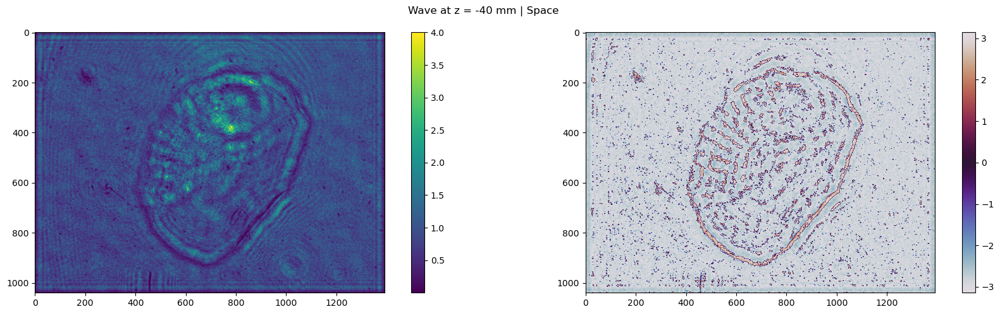

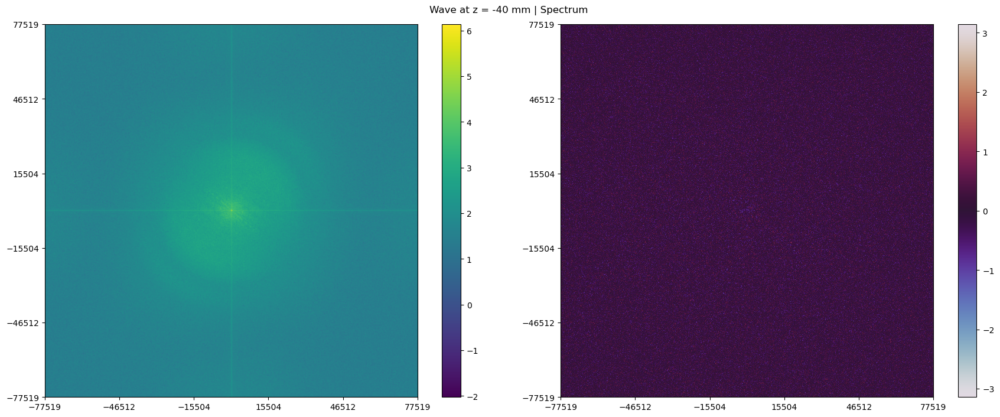

In [16]:
dist = -40 # mm

wave_z = wave_obj.propogate(dist)

fig, axs = plt.subplots(1, 2, figsize=(18, 5), tight_layout=True)
# cp_amp = axs[0].imshow(np.abs(wave_z)**2)
cp_amp = axs[0].imshow(np.clip((np.abs(wave_z)**2), 0, 4))
cp_ang = axs[1].imshow(((np.angle(wave_z))), cmap='twilight')

fig.colorbar(cp_amp, ax=axs[0])
fig.colorbar(cp_ang, ax=axs[1])
fig.suptitle(f'Wave at z = {dist} mm | Space')
plt.show()

fig, axs = plt.subplots(1, 2, figsize=(18, 7), tight_layout=True)

cp_amp = axs[0].imshow(np.log10(np.abs(wave_obj.fft_wave_z1)), 
                       extent=[-1/(2*wave_obj.sizePx[0]), 1/(2*wave_obj.sizePx[0]), -1/(2*wave_obj.sizePx[1]), 1/(2*wave_obj.sizePx[1])])

cp_ang = axs[1].imshow(np.angle(wave_obj.fft_wave_z1), cmap='twilight', 
                       extent=[-1/(2*wave_obj.sizePx[0]), 1/(2*wave_obj.sizePx[0]), -1/(2*wave_obj.sizePx[1]), 1/(2*wave_obj.sizePx[1])])

axs[0].set_xticks(np.linspace(-1/(2*wave_obj.sizePx[0]), 1/(2*wave_obj.sizePx[0]), 6))
axs[0].set_yticks(np.linspace(-1/(2*wave_obj.sizePx[1]), 1/(2*wave_obj.sizePx[1]), 6))

axs[1].set_xticks(np.linspace(-1/(2*wave_obj.sizePx[0]), 1/(2*wave_obj.sizePx[0]), 6))
axs[1].set_yticks(np.linspace(-1/(2*wave_obj.sizePx[1]), 1/(2*wave_obj.sizePx[1]), 6))

fig.colorbar(cp_amp, ax=axs[0])
fig.colorbar(cp_ang, ax=axs[1])

fig.suptitle(f'Wave at z = {dist} mm | Spectrum')
plt.show()